# Video Processing and Object Detection with Faster RCNN with Resnet50 as base model

Library Package Versions:
- pafy==0.5.5
- numpy==1.18.5
- mxnet==1.6.0
- matplotlib==3.2.2
- gluoncv==0.7.0

First let us install the necessary libraries for this notebook

In [ ]:
pip install git+https://github.com/Cupcakus/pafy   #library for getting videos from YouTube in colab
#pip3 install git+https://github.com/Cupcakus/pafy  #In local system

In [ ]:
pip install youtube_dl  #library to download videos from youtube

     |████████████████████████████████| 1.9 MB 33.9 MB/s 


In [ ]:
pip install gluoncv    #Deep learning framework for quick experimentation with pre-trained models

     |████████████████████████████████| 1.3 MB 31.4 MB/s 


In [ ]:
pip install mxnet     # backend on which gluoncv is built on by Apache

     |████████████████████████████████| 46.9 MB 43 kB/s 
  Attempting uninstall: graphviz
    Found existing installation: graphviz 0.10.1
    Uninstalling graphviz-0.10.1:
      Successfully uninstalled graphviz-0.10.1


In [ ]:
# conda install -c conda-forge google-colab ## If using this copmmand from google.colab.patches import cv2_imshow in local system

In [1]:
# import libraries
import cv2          #for image processing
import pafy
import numpy as np
from matplotlib import pyplot as plt      #for plotting purposes                        #matrix operations
import mxnet as mx
import gluoncv
from gluoncv import model_zoo, data, utils
from google.colab.patches import cv2_imshow   #plotting in google colab, equivalent of cv2.imshow

/Users/gowthamswaminathan/opt/anaconda3/lib/python3.7/site-packages/gluoncv/__init__.py:40: UserWarning: Both `mxnet==1.8.0` and `torch==1.11.0` are installed. You might encounter increased GPU memory footprint if both framework are used at the same time.
  warnings.warn(f'Both `mxnet=={mx.__version__}` and `torch=={torch.__version__}` are installed. '
/Users/gowthamswaminathan/opt/anaconda3/lib/python3.7/site-packages/google/colab/data_table.py:30: UserWarning: IPython.utils.traitlets has moved to a top-level traitlets package.
  from IPython.utils import traitlets as _traitlets


Get pre-trained Faster RCNN with base model Resnet 50  trained on Pascal Visual Object Classes dataset: 

http://host.robots.ox.ac.uk/pascal/VOC/

We are using GluonCV library in this notebook for doing computer vision. It's a great library for building production level code for deployment purposes. We are using model_zoo module from gluonCV. You can read more on this here:

https://gluon-cv.mxnet.io/model_zoo/index.html

You can read more on Faster RCNN model and the Resnet model from the official paper:

https://arxiv.org/pdf/1506.01497.pdf

Resnet:

https://arxiv.org/pdf/1512.03385.pdf

A short tutorial on how to use pre-trained Faster RCNN with Resnet50 on GluonCV can be found here:

https://gluon-cv.mxnet.io/build/examples_detection/demo_faster_rcnn.html

In [2]:
net = model_zoo.get_model('faster_rcnn_resnet50_v1b_voc', pretrained=True)         # get pretrained Faster RCNN with Resnet50 as base model v3 model from model_zoo class of gluoncv
url = 'https://youtu.be/0jO7OYTgHis'                 # specify the video url on which you wish to do object detection

In [3]:
vPafy = pafy.new(url)                     # vpafy is a pafy object to convert the url into a video to be accessed for this notebook
play = vPafy.getbest()                    # method to get best resolution irrespective of file format

Let us write a function that will take in a frame of video and perform object detection on it. (the commented code is for you to understand the pre-processing that is done before feeding into the model). However, we don't need the same as gluoncv offers the same in the form of transforms module. But I'm keeping it to give you an understanding of what's happening in the backround.

In [4]:
def detect_and_label(rgb_frame):
    # print(rgb_frame.shape)
    # type(rgb_frame)
    # img = cv2.resize(rgb_frame, (600, 956))     
    # # print(type(img)
    # arr3d = np.reshape(img, (3,600,956))
    # arr4d = np.expand_dims(arr3d, 0)
    # # print(arr4d.shape)
    final_array = mx.nd.array(rgb_frame)        # convert the video frame into mxnet numpy array
    x, img = gluoncv.data.transforms.presets.rcnn.transform_test(final_array)     # transform the array for model input shape
    # print(type(final_array))
    class_IDs, scores, bounding_boxes = net(x)            # get the class Ids, confidence scores and bounding boxes by passing the array through the model
    ax = utils.viz.plot_bbox(img, bounding_boxes[0], scores[0],
                             class_IDs[0], class_names=net.classes) # create an axis object with the information and respective classes
    # print("BB", type(bounding_boxes[0]))
    # print("scores", type(scores[0]))
    # print("class_IDs", type(class_IDs[0]))
    # print(bounding_boxes[0].shape)
    # print(scores[0].shape)
    # print(class_IDs[0].shape)
    # Display the resulting image
    plt.rcParams['figure.figsize'] = [80, 50]
    plt.show(block=False)         
    plt.pause(0.0001)
    plt.close()       # I've plotted it this way to stop the plt.show from blocking the next video frame so you can view results
                      # in real time. However, this will depend on how much fps your system supports.


Now let us write a function to play the original video file that we get from the youtube url. (This function will run till we do not interrupt it, so incase you want to stop running this function go to Runtime --> Interrupt Execution). This function does not return anything.

In [5]:
def play_original_video():
  #start the video

    cap = cv2.VideoCapture(play.url)

    while True:
        # Grab a single frame of video
        ret, frame = cap.read()

        # Convert the image from BGR color (which OpenCV uses) to RGB color (which face_recognition uses)
        rgb_frame = frame[:, :, ::-1]
        cv2_imshow(frame)         # to plot each frame of the video
        if cv2.waitKey(10) & 0xFF == ord('q'):
            break
    cap.release()
    cv2.destroyAllWindows()     # handle interrupts

Let us write a function that will read each frame of the video and pass it to the function that we wrote earlier in order to do end to end object detection in video.  (This function will run till we do not interrupt it, so incase you want to stop running this function go to Runtime --> Interrupt Execution). This function does not return anything.

In [6]:
def do_video_object_detection():
    #start the video
    cap = cv2.VideoCapture(play.url)

    while True:
        # Grab a single frame of video
        ret, frame = cap.read()


        # Convert the image from BGR color (which OpenCV uses) to RGB color (which face_recognition uses)
        rgb_frame = frame[:, :, ::-1]

        # do face recognition here
        detect_and_label(rgb_frame)      # call our object detection function
        if cv2.waitKey(10) & 0xFF == ord('q'):
            break
    cap.release()
    cv2.destroyAllWindows()       # handle interrupts

Now let us call both the functions that we wrote, one to see the frames of the original video and another to do object detection on those frames using Faster RCNN with Resnet50.

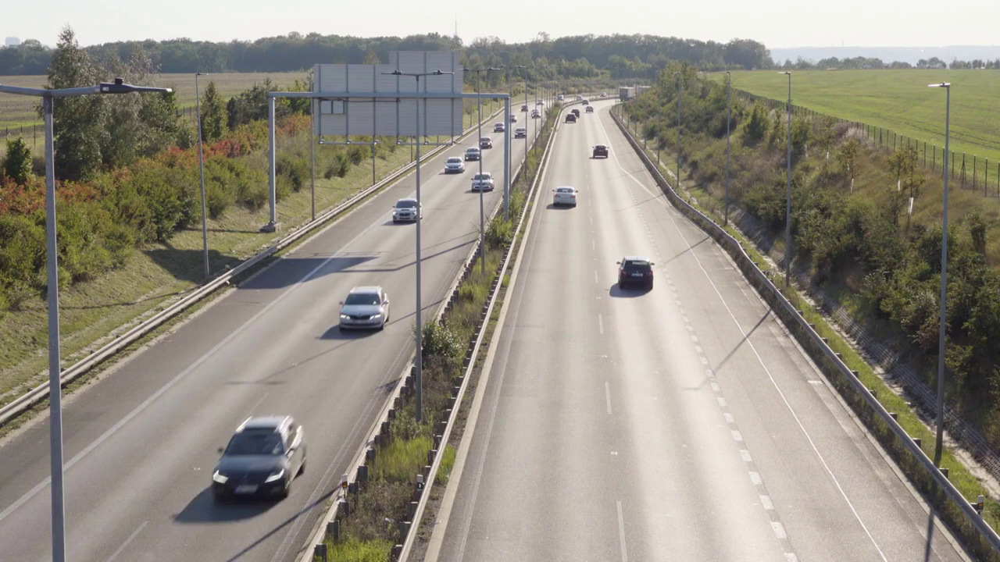

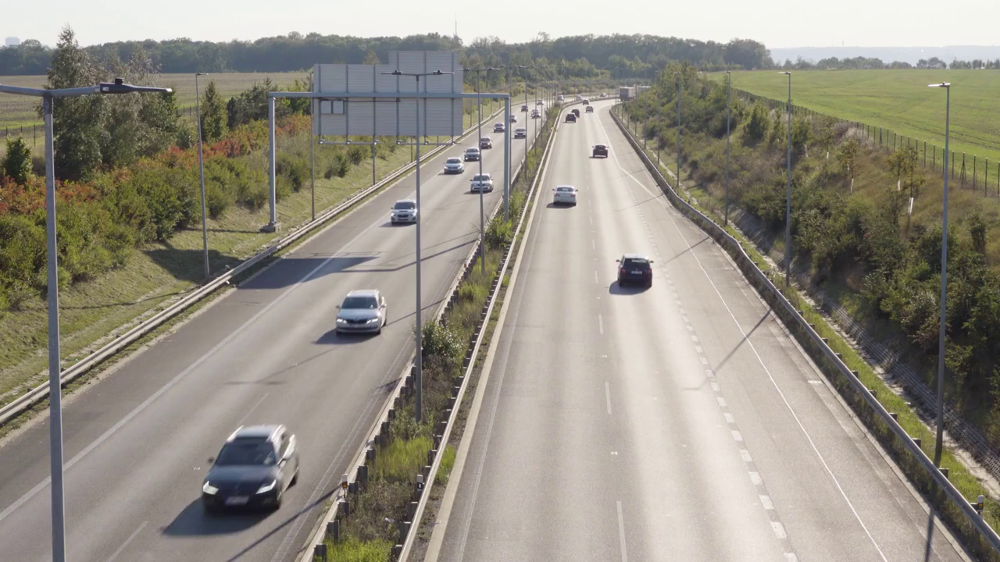

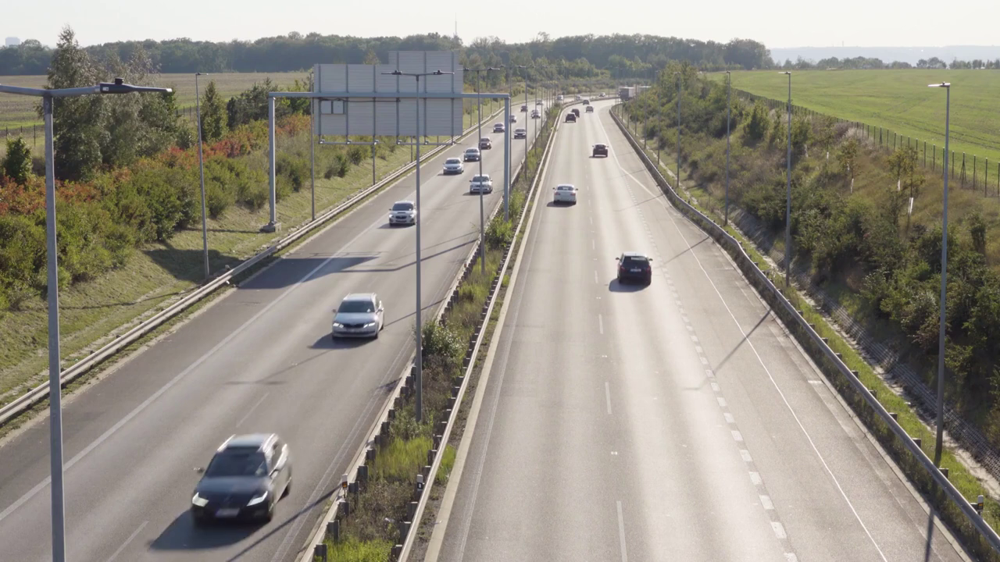

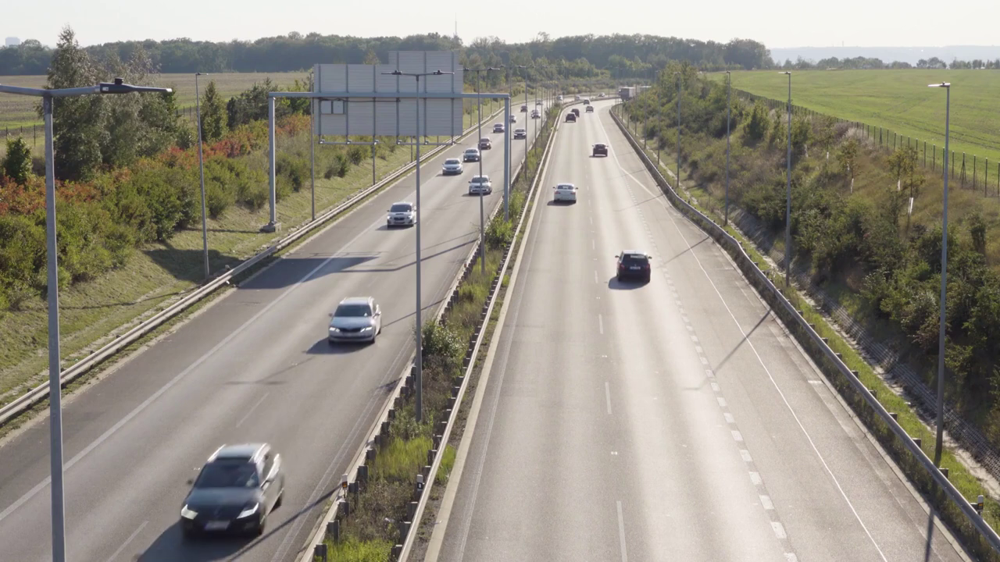

KeyboardInterrupt: 

In [8]:
play_original_video()

# Let's do object detection on these frames

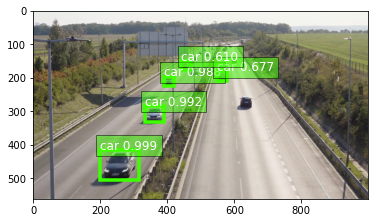

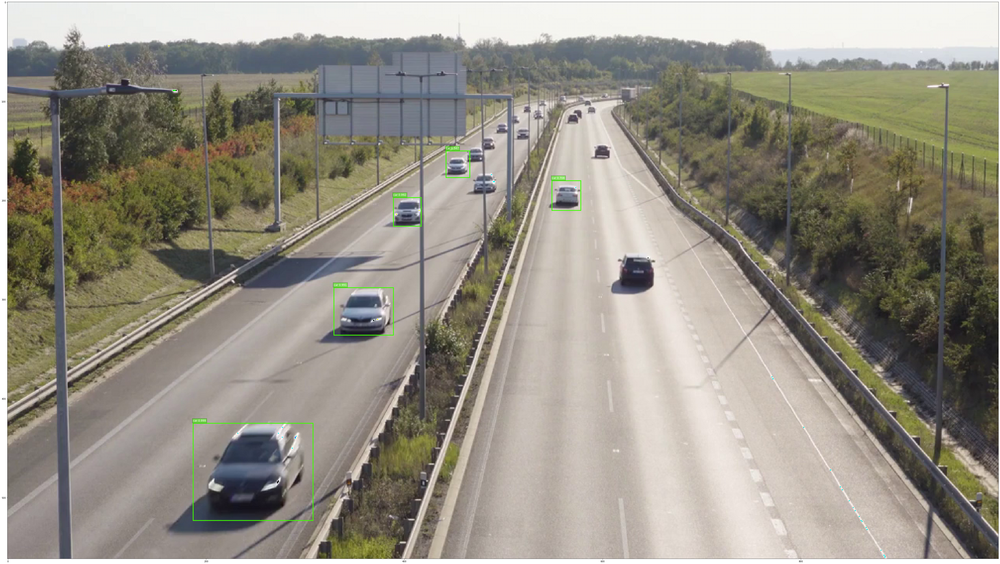

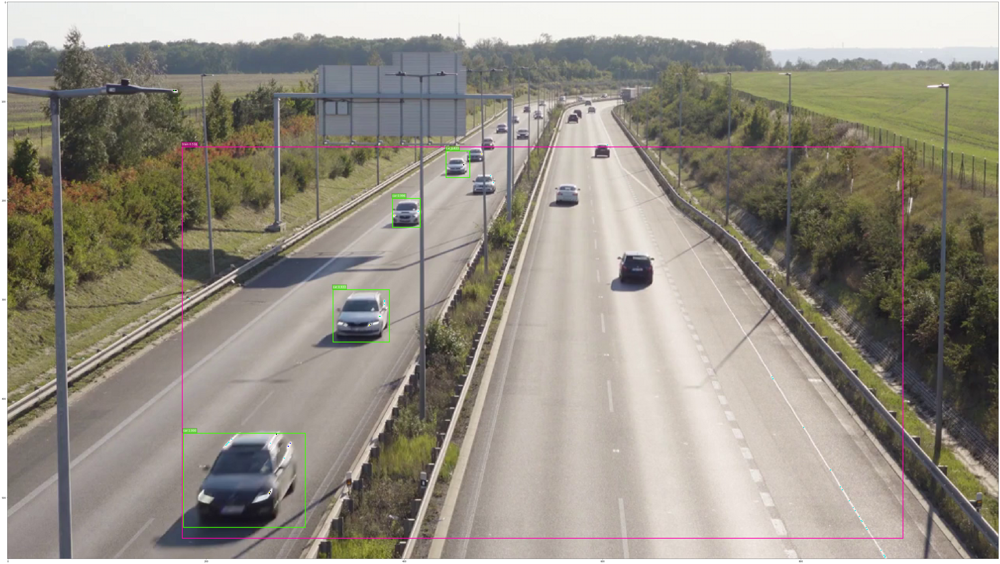

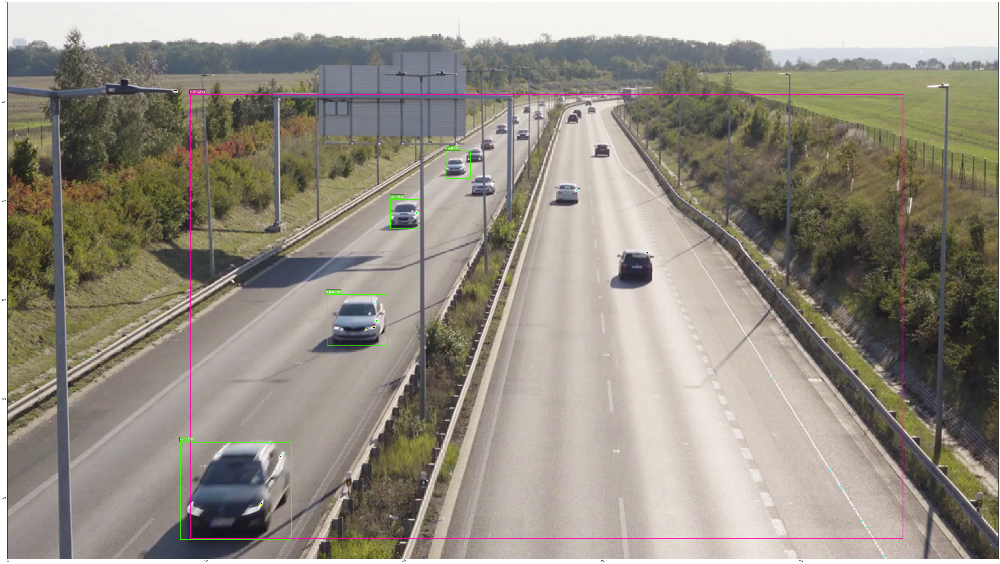

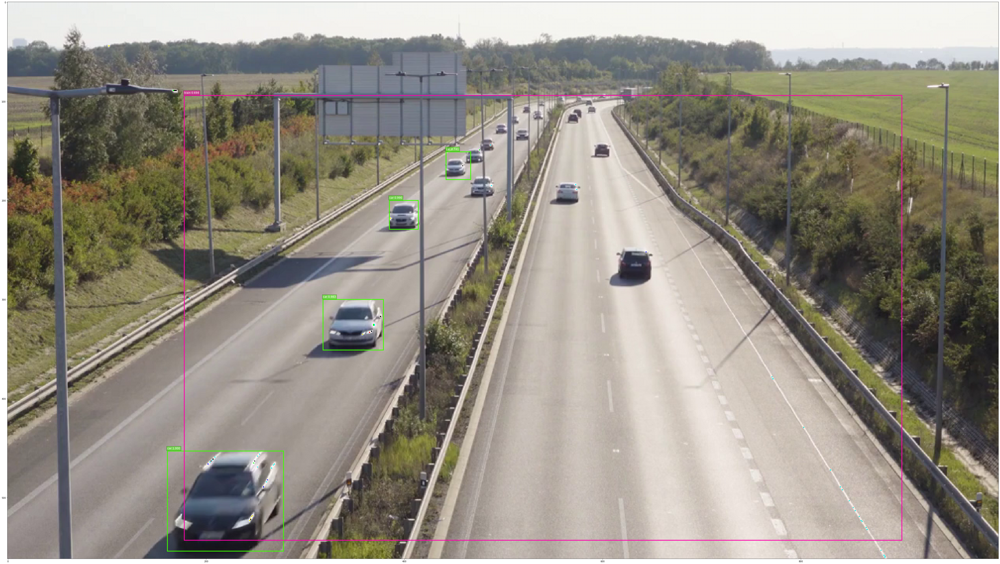

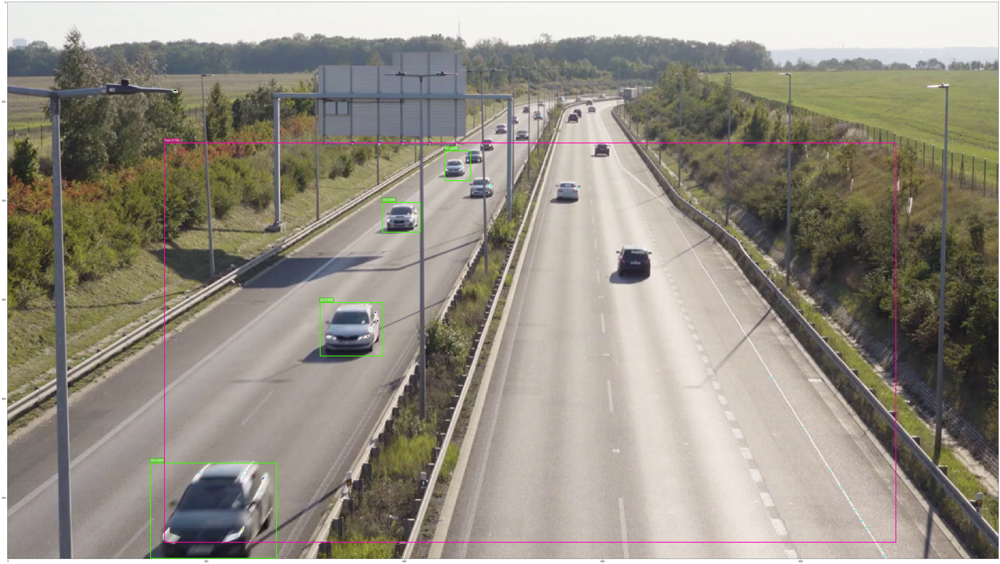

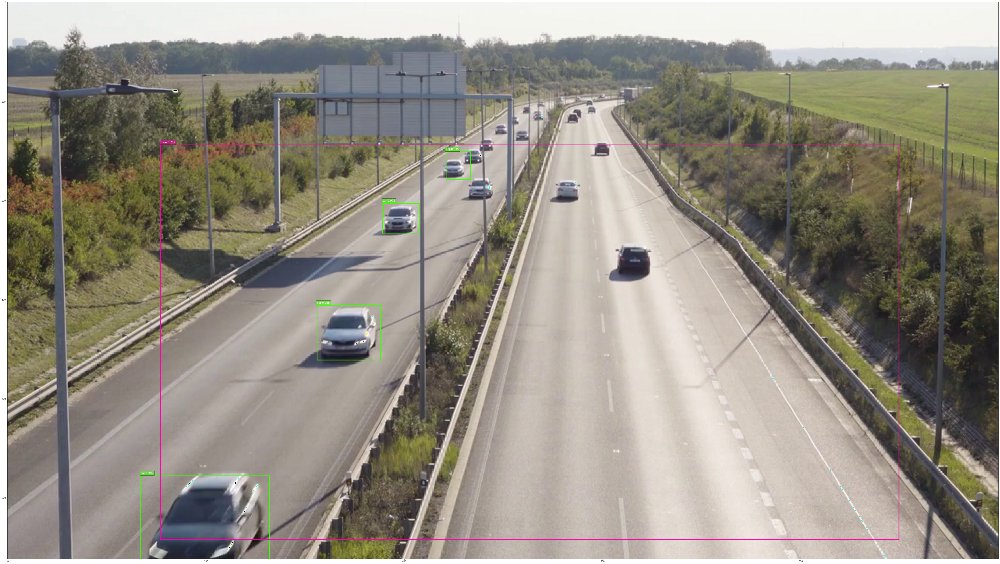

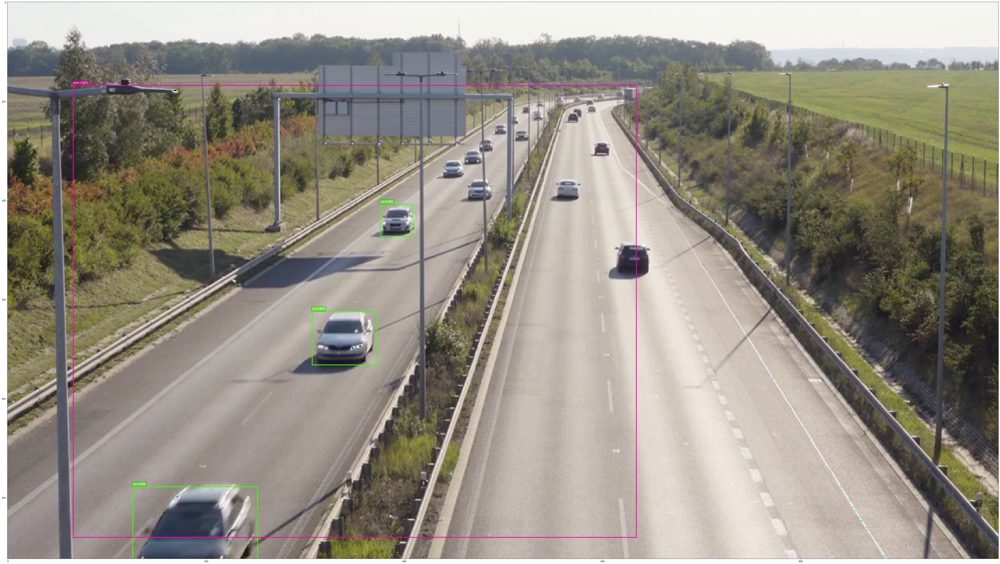

KeyboardInterrupt: 

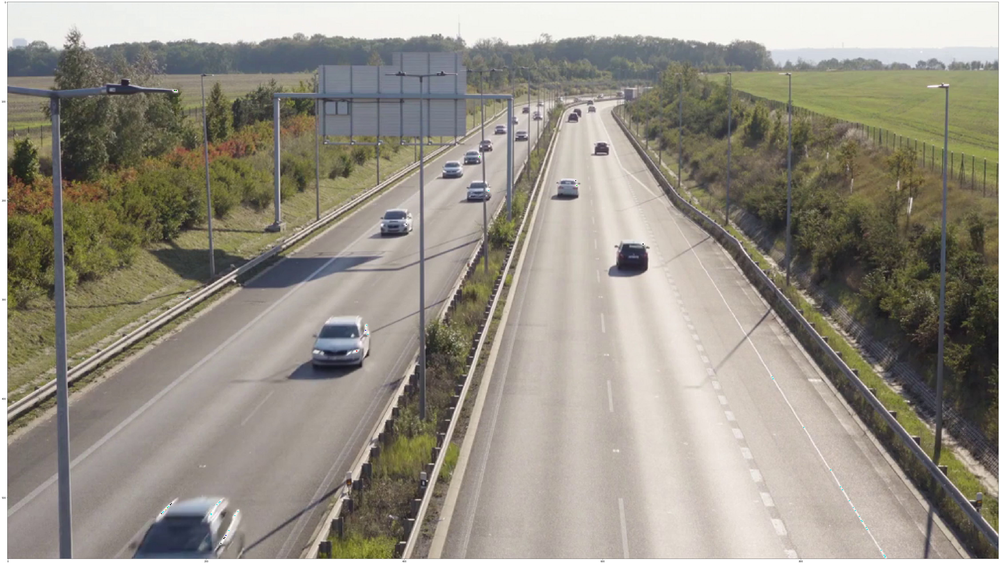

In [7]:
do_video_object_detection()       # Zoom into subsequent images to see the class names clearly

Thus, we are able to do object detection using RCNN with ResNet 50 and the model is predicting the respective classes with their equivalent confidence scores.